In [2]:
import json
import datetime

# Data manipulation and analysis
import pandas as pd
import numpy as np
import pandas_profiling as pp

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# Preprocessing and pipeline utilities
from sklearn import preprocessing
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, MinMaxScaler, RobustScaler, PowerTransformer, QuantileTransformer, LabelEncoder, OrdinalEncoder, Binarizer

# Machine Learning Models
#from cuml import SVC as cuSVC

from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import ( ExtraTreesClassifier,StackingClassifier, VotingClassifier)
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import (
    LogisticRegression, RidgeClassifier, PassiveAggressiveClassifier, Perceptron, SGDClassifier
)
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.tree import DecisionTreeClassifier

# Model Evaluation and Selection
from sklearn.calibration import CalibratedClassifierCV
from sklearn.feature_selection import SelectKBest, f_classif
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold
from sklearn.metrics import (
    accuracy_score, confusion_matrix, classification_report, roc_curve, auc, get_scorer,roc_auc_score
)
from catboost import CatBoostClassifier

'2.8.0'

# Table of Contents
____

In [4]:
df1_train = pd.read_csv('../data/train.csv')
df1_test = pd.read_csv('../data/test.csv')
df2_train = pd.read_csv('../data/train_dataset.csv')

lets concatenate the training datasets from playground_series_s3e23 and the original dataset from kaggle to get a bigger dataset to train our model on.

In [5]:
df2_train['id'] = np.nan
combined_train_df = pd.concat([df1_train, df2_train], axis=0)
combined_train_df = combined_train_df.reset_index(drop=True)
combined_train_df

,id,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
0,0.0,55,165,60,81.0,0.5,0.6,1,1,135,...,40,75,16.5,1,1.0,22,25,27,0,1
1,1.0,70,165,65,89.0,0.6,0.7,2,2,146,...,57,126,16.2,1,1.1,27,23,37,1,0
2,2.0,20,170,75,81.0,0.4,0.5,1,1,118,...,45,93,17.4,1,0.8,27,31,53,0,1
3,3.0,35,180,95,105.0,1.5,1.2,1,1,131,...,38,102,15.9,1,1.0,20,27,30,1,0
4,4.0,30,165,60,80.5,1.5,1.0,1,1,121,...,44,93,15.4,1,0.8,19,13,17,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
198235,NaN,40,165,60,80.0,0.4,0.6,1,1,107,...,61,72,12.3,1,0.5,18,18,21,1,0
198236,NaN,45,155,55,75.0,1.5,1.2,1,1,126,...,76,131,12.5,2,0.6,23,11,12,0,0
198237,NaN,40,170,105,124.0,0.6,0.5,1,1,141,...,48,138,17.1,1,0.8,24,23,35,1,1
198238,NaN,40,160,55,75.0,1.5,1.5,1,1,95,...,79,116,12.0,1,0.6,24,20,17,0,1


In [4]:
pp.ProfileReport(combined_train_df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
#%%time
def analyze_dataframe(df):
    """
    Analyze a pandas DataFrame and provide a summary of its characteristics.

    Parameters:
    df (pandas.DataFrame): The input DataFrame to analyze.

    Returns:
    None
    """
    print("DataFrame Information:")
    print("______________________")
    display(df.info(verbose=True, show_counts=True))
    print("\n")
    
    print("DataFrame Head:")
    print("______________________")
    display(df.head())
    print("\n")

    print("DataFrame Tail:")
    print("______________________")
    display(df.tail())
    print("\n")

    print("DataFrame Description:")
    print("______________________")
    display(df.describe().T)
    print("\n")

    print("Number of Null Values:")
    print("______________________")
    display(df.isnull().sum())
    print("\n")

    print("Number of Duplicated Rows:")
    print("______________________")
    display(df.duplicated().sum())
    print("\n")

    print("Number of Unique Values:")
    print("______________________")
    display(df.nunique())
    print("\n")

    print("DataFrame Shape:")
    print("______________________")
    print(f"Rows: {df.shape[0]}, Columns: {df.shape[1]}")

# graph out to find outliers
# Usage
analyze_dataframe(combined_train_df)

DataFrame Information:
______________________
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 198240 entries, 0 to 198239
Data columns (total 24 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   id                   159256 non-null  float64
 1   age                  198240 non-null  int64  
 2   height(cm)           198240 non-null  int64  
 3   weight(kg)           198240 non-null  int64  
 4   waist(cm)            198240 non-null  float64
 5   eyesight(left)       198240 non-null  float64
 6   eyesight(right)      198240 non-null  float64
 7   hearing(left)        198240 non-null  int64  
 8   hearing(right)       198240 non-null  int64  
 9   systolic             198240 non-null  int64  
 10  relaxation           198240 non-null  int64  
 11  fasting blood sugar  198240 non-null  int64  
 12  Cholesterol          198240 non-null  int64  
 13  triglyceride         198240 non-null  int64  
 14  HDL                  1

None



DataFrame Head:
______________________


,id,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
0,0.0,55,165,60,81.0,0.5,0.6,1,1,135,...,40,75,16.5,1,1.0,22,25,27,0,1
1,1.0,70,165,65,89.0,0.6,0.7,2,2,146,...,57,126,16.2,1,1.1,27,23,37,1,0
2,2.0,20,170,75,81.0,0.4,0.5,1,1,118,...,45,93,17.4,1,0.8,27,31,53,0,1
3,3.0,35,180,95,105.0,1.5,1.2,1,1,131,...,38,102,15.9,1,1.0,20,27,30,1,0
4,4.0,30,165,60,80.5,1.5,1.0,1,1,121,...,44,93,15.4,1,0.8,19,13,17,0,1




DataFrame Tail:
______________________


,id,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
198235,NaN,40,165,60,80.0,0.4,0.6,1,1,107,...,61,72,12.3,1,0.5,18,18,21,1,0
198236,NaN,45,155,55,75.0,1.5,1.2,1,1,126,...,76,131,12.5,2,0.6,23,11,12,0,0
198237,NaN,40,170,105,124.0,0.6,0.5,1,1,141,...,48,138,17.1,1,0.8,24,23,35,1,1
198238,NaN,40,160,55,75.0,1.5,1.5,1,1,95,...,79,116,12.0,1,0.6,24,20,17,0,1
198239,NaN,55,175,60,81.1,1.0,1.0,1,1,114,...,64,137,13.9,1,1.0,18,12,16,0,1




DataFrame Description:
______________________


,count,mean,std,min,25%,50%,75%,max
id,159256.0,79627.500000,45973.391572,0.0,39813.75,79627.5,119441.25,159255.0
age,198240.0,44.271418,11.886308,20.0,40.00,40.0,55.00,85.0
height(cm),198240.0,165.153375,8.895587,130.0,160.00,165.0,170.00,190.0
weight(kg),198240.0,66.906709,12.656868,30.0,55.00,65.0,75.00,135.0
waist(cm),198240.0,82.817163,9.039363,51.0,77.00,83.0,89.00,129.0
eyesight(left),198240.0,1.007599,0.422827,0.1,0.80,1.0,1.20,9.9
eyesight(right),198240.0,1.002519,0.414241,0.1,0.80,1.0,1.20,9.9
hearing(left),198240.0,1.024248,0.153820,1.0,1.00,1.0,1.00,2.0
hearing(right),198240.0,1.023966,0.152943,1.0,1.00,1.0,1.00,2.0
systolic,198240.0,122.301488,12.920634,71.0,113.00,121.0,130.00,233.0




Number of Null Values:
______________________


id                     38984
age                        0
height(cm)                 0
weight(kg)                 0
waist(cm)                  0
eyesight(left)             0
eyesight(right)            0
hearing(left)              0
hearing(right)             0
systolic                   0
relaxation                 0
fasting blood sugar        0
Cholesterol                0
triglyceride               0
HDL                        0
LDL                        0
hemoglobin                 0
Urine protein              0
serum creatinine           0
AST                        0
ALT                        0
Gtp                        0
dental caries              0
smoking                    0
dtype: int64



Number of Duplicated Rows:
______________________


5517



Number of Unique Values:
______________________


id                     159256
age                        18
height(cm)                 15
weight(kg)                 29
waist(cm)                 548
eyesight(left)             20
eyesight(right)            18
hearing(left)               2
hearing(right)              2
systolic                  128
relaxation                 94
fasting blood sugar       259
Cholesterol               279
triglyceride              393
HDL                       123
LDL                       286
hemoglobin                144
Urine protein               6
serum creatinine           34
AST                       196
ALT                       230
Gtp                       444
dental caries               2
smoking                     2
dtype: int64



DataFrame Shape:
______________________
Rows: 198240, Columns: 24


drop the duplicate rows

In [7]:
combined_train_df.drop_duplicates(inplace=True)

# EDA

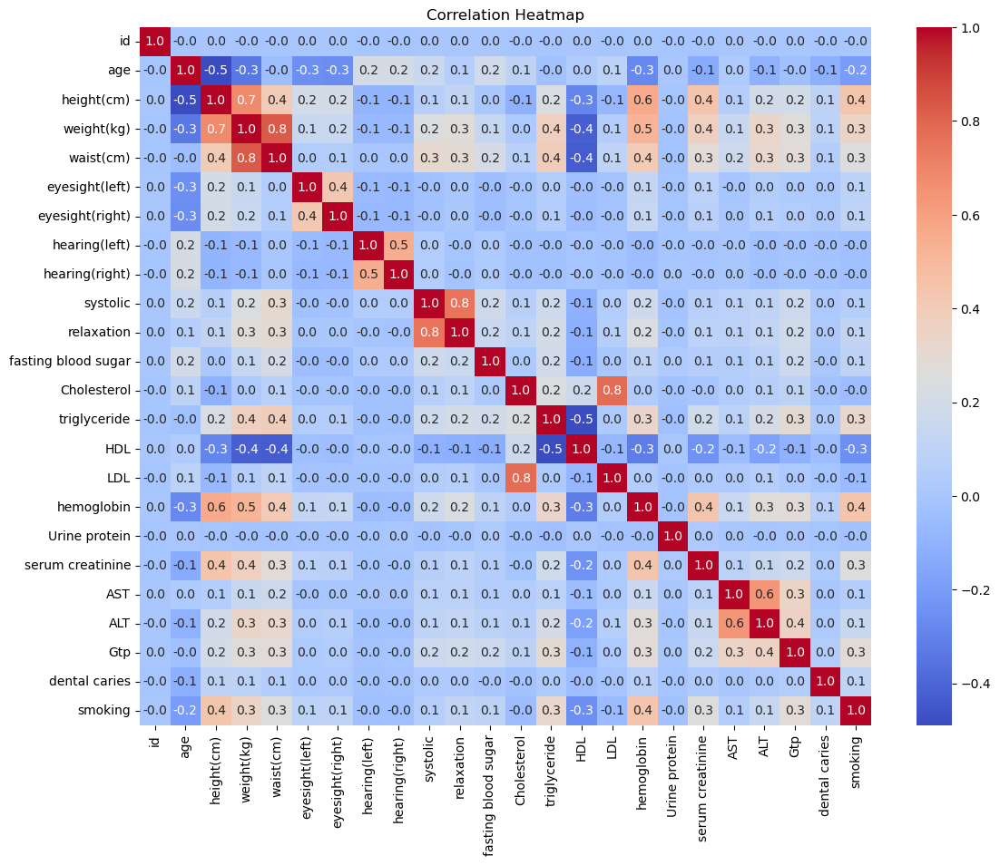

In [11]:
#create heatmap to find correlation
corr = combined_train_df.corr()
plt.figure(figsize=(13,10))
sns.heatmap(corr, annot=True, fmt='.1f', cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

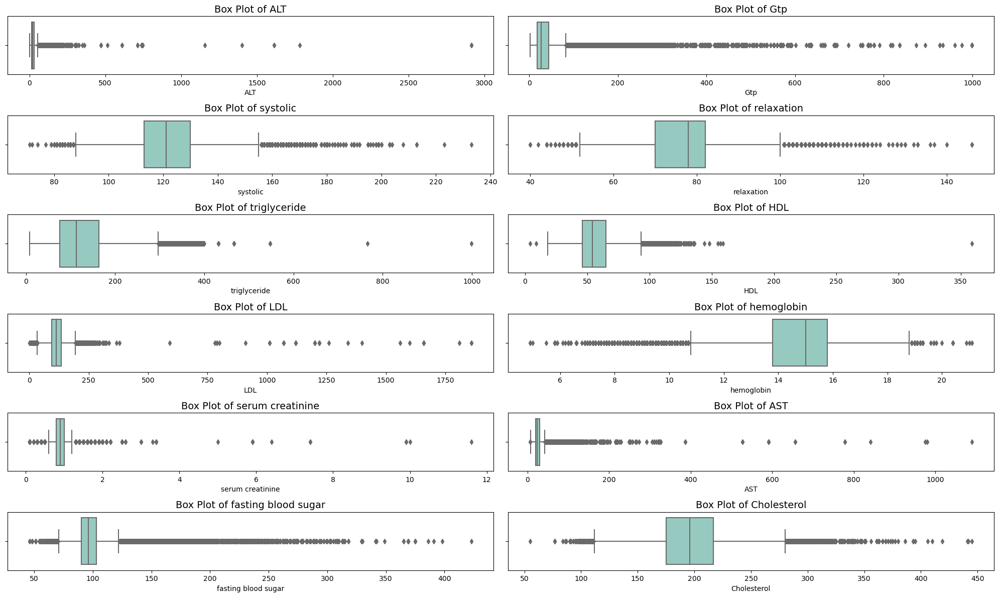

In [12]:
def prelim_eda_boxplot(df):

    columns_to_plot= df.drop(['id', 'Hardness'], axis=1)

    num_columns = len(columns_to_plot)
    num_rows = (num_columns + 1) // 2  # Adjust the number of rows as needed
    fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(20, 12))

    # Loop over selected columns and create box plots in separate subplots
    for i, column in enumerate(columns_to_plot):
        row = i // 2
        col = i % 2
        sns.boxplot(x=df[column], ax=axes[row, col],palette="Set3")
        axes[row, col].set_title(f'Box Plot of {column}', fontsize=14)

    # Remove empty subplots (if any)
    for i in range(num_columns, num_rows * 2):
        fig.delaxes(axes.flatten()[i])

    # Adjust layout
    plt.tight_layout()
    plt.show()
prelim_eda_boxplot(combined_train_df)


Here are the normal levels for the following values in the human body:

- Fasting blood sugar: 70-99 mg/dL (American Diabetes Association)
- Cholesterol: Total cholesterol < 200 mg/dL, LDL cholesterol < 100 mg/dL, HDL cholesterol > 40 mg/dL (American Heart Association)
- Triglyceride: < 150 mg/dL (American Heart Association)
- HDL: > 60 mg/dL (American Heart Association)
- LDL: < 100 mg/dL (American Heart Association)
- Hemoglobin: 12-16 g/dL for women, 14-18 g/dL for men (Mayo Clinic)
- Urine protein: < 150 mg/day (National Kidney Foundation)
- Serum creatinine: 0.6-1.3 mg/dL for men, 0.5-1.1 mg/dL for women (Mayo Clinic)
- AST: 10-40 U/L (Mayo Clinic)
- ALT: 7-56 U/L (Mayo Clinic)
- GTP: 9-48 U/L for men, 9-35 U/L for women (Mayo Clinic)
- Systolic Blood Pressure	Blood Pressure Category (Mayo Clinic)
    - Elevated: Systolic between 120-129 mm Hg
    - Hypertension stage 1: Systolic between 130-139 mm Hg
    - Hypertension stage 2: Systolic 140 mm Hg or higher
    - Hypertensive crisis: Systolic higher than 180 mm Hg

## Preprocessing function and feature engineering

In [13]:
def preprocessing(df):
    # remove outliers
    # lets remove hearing as well to test the model
    # add bmi feature
    # add age group features
    # add hypertension group feature


    df = df.drop(columns=['id','height(cm)'])
    return df

In [14]:
pp_train_df = preprocessing(combined_train_df)
pp_test_df = preprocessing(df1_test)
pp_train_df.to_csv('../data/train_preprocessed.csv', index=False)
pp_test_df.to_csv('../data/test_preprocessed.csv', index=False)

In [16]:
pp_test_df = pd.read_csv('../data/train_preprocessed.csv')
pp_test_df.columns

Index(['age', 'weight(kg)', 'waist(cm)', 'eyesight(left)', 'eyesight(right)',
       'hearing(left)', 'hearing(right)', 'systolic', 'relaxation',
       'fasting blood sugar', 'Cholesterol', 'triglyceride', 'HDL', 'LDL',
       'hemoglobin', 'Urine protein', 'serum creatinine', 'AST', 'ALT', 'Gtp',
       'dental caries', 'smoking'],
      dtype='object')

In [2]:
df = pd.read_csv('../data/train_preprocessed.csv')

# Separate features and target variable
X = df.drop(columns=["smoking"])
y = df["smoking"]

# Define numeric and categorical features
numeric_features = ['age','weight(kg)', 'waist(cm)', 'eyesight(left)', 'eyesight(right)', 'systolic','relaxation', 'fasting blood sugar', 'Cholesterol', 'triglyceride','HDL', 'LDL', 'hemoglobin', 'Urine protein', 'serum creatinine', 'AST', 'ALT', 'Gtp']
categorical_features = ['dental caries']
# Create transformers for numeric and categorical features
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('encoder', OneHotEncoder(handle_unknown='ignore'))
])

# Use ColumnTransformer to apply transformers to the appropriate columns
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
])

In [3]:

#list of classifiers and their respective hyperparameter grids
classifiers = {
    # 'CatBoost': (CatBoostClassifier(), {
    
    #     'classifier__learning_rate': [0.05],
    #     'classifier__random_seed': [42],
    #     'classifier__loss_function': ['Logloss'],
    #     'classifier__verbose': [False]
    # }),

    # 'SVM': (SVC(), {
    #     'classifier__C': list(range(5,10)),
    #     'classifier__kernel': ['rbf','poly', 'sigmoid'],
    #     'classifier__gamma': list(np.arange(0.01,0.1,0.01)),  
    #     'classifier__probability': [True],
    #     'classifier__class_weight': ['balanced', None],
    #     'classifier__shrinking': [True],
    #     'classifier__random_state': [42]
    # }),

    # 'Logistic Regression': (LogisticRegression(), { 
    #     'classifier__C': [.5],
    #     'classifier__penalty': ['l1'],       
    #     'classifier__solver': ['liblinear'],
    #     'classifier__random_state': [42]
    # }),

    # 'Random Forest': (RandomForestClassifier(), {
    #     'classifier__n_estimators': [157],  # Number of trees in the forest
    #     'classifier__criterion': ['entropy'],  # Splitting criterion
    #     'classifier__max_depth': [20],  # Maximum depth of trees
    #     'classifier__min_samples_split': [5],  # Minimum samples required to split a node
    #     'classifier__min_samples_leaf': [2],  # Minimum samples required at a leaf node
    #     'classifier__max_features': ['log2'],  # Number of features to consider
    #     'classifier__class_weight': ['balanced'],  # Class weights for the RandomForestClassifier
    #     'classifier__random_state': [42]
    #}),

    # 'XGBoost': (XGBClassifier(), {
    #     #'classifier__tree_method': ['gpu_hist'],
        
    #     'classifier__learning_rate': np.arange(0.05,0.1,0.01),      # Learning rate
    #     'classifier__n_estimators': [97],          # Number of boosting rounds
    #     'classifier__max_depth': [3],                 # Maximum depth of trees
    #     'classifier__subsample': [0.8],           # Fraction of samples used for fitting the trees
    #     'classifier__colsample_bytree': [0.8],    # Fraction of features used for fitting the trees
    #     'classifier__random_state': [42]
    # }),


    # 'K-Nearest Neighbors': (KNeighborsClassifier(), {
    #     'classifier__n_neighbors': list(range(2,20)),  # Number of neighbors
    #     'classifier__weights': ['distance'],  # Weight function
    #     'classifier__p': [1,2],  # Distance metric (1 for Manhattan, 2 for Euclidean)
    #     'classifier__algorithm': ['auto'],  # Algorithm used to compute nearest neighbors
    #     'classifier__leaf_size': [1],  # Leaf size for tree-based algorithms
    #     'classifier__metric': ['manhattan']  # Distance metric for tree-based algorithms
    # }),

    # 'MLP Neural Network': (MLPClassifier(), {
    #     'classifier__learning_rate_init': [0.005],  # Initial learning rate
    #     'classifier__hidden_layer_sizes': [(275),],
    #     'classifier__alpha': [0.1],  # L2 penalty (regularization term)
    #     'classifier__activation': ['tanh'],  # Activation function
    #     'classifier__solver': ['adam'],  # Solver for weight optimization
    #     'classifier__learning_rate': ['constant'],  # Learning rate schedule
    #     'classifier__max_iter': [1000],  # Maximum number of iterations
    #     'classifier__random_state': [42]  # Random state for reproducibility
    # }),

    # 'Decision Tree': (DecisionTreeClassifier(), {
    #     'classifier__criterion': ['gini'],
    #     'classifier__max_depth': list(range(10,21)),
    #     'classifier__min_samples_split': list(range(2,7)),
    #     'classifier__min_samples_leaf': [1],
    #     'classifier__max_features': [None, 'sqrt', 'log2', 0.5],  # Add valid values here
    #     'classifier__random_state': [42]
    # }),

    # 'Extra Trees': (ExtraTreesClassifier(), {
    #     'classifier__n_estimators': [162],  # Number of decision trees in the forest
    #     'classifier__criterion': ['entropy'],  # Criterion for splitting
    #     'classifier__max_depth': [None],     # Maximum depth of the trees
    #     'classifier__min_samples_split': [3],  # Minimum samples required to split a node
    #     'classifier__min_samples_leaf': [16],    # Minimum samples required at leaf nodes
    #     'classifier__max_features': [None],  # Number of features to consider at each split
    #     'classifier__random_state': [42]
    # }),

    

    # 'SGD Classifier': (SGDClassifier(), {
    #     'classifier__alpha': [0.0001, 0.001, 0.01,0.1],  # Regularization strength
    #     'classifier__penalty': ['l1', 'l2', 'elasticnet'],  # Regularization penalty
    #     'classifier__loss': ['hinge', 'log', 'modified_huber'],  # Loss function
    #     'classifier__random_state': [42]
    # }),
    
    # 'Voting Classifier': (VotingClassifier(estimators=[
    #     ('lr', LogisticRegression(random_state=42, C=0.93, penalty='l1', solver='liblinear')),
    #     ('svc', SVC(random_state=42, C=8, gamma=0.009, kernel='rbf', probability=True, class_weight='balanced', shrinking=True)),
    #     ('rf', RandomForestClassifier(random_state=42, n_estimators=157, criterion='entropy', max_depth=20, min_samples_split=5, min_samples_leaf=2, max_features='log2', class_weight='balanced')),
    #     ('et', ExtraTreesClassifier(random_state=42, n_estimators=162, criterion='entropy', max_depth=None, min_samples_split=3, min_samples_leaf=16, max_features=None)),
    #     ('xgb', XGBClassifier(random_state=42, learning_rate=0.09, n_estimators=97, max_depth=3, subsample=0.8, colsample_bytree=0.8)),
    #     ('mlp', MLPClassifier(random_state=42, max_iter=1000, hidden_layer_sizes=(200,), activation='tanh', solver='adam', alpha=0.12, learning_rate='constant'))
    # ], voting='soft'), {}),

    # 'Stacking Classifier': (StackingClassifier(estimators=[
    #     ('cat', CatBoostClassifier(random_state=42, loss_function='Logloss', verbose=False)),
    # #     ('knn', KNeighborsClassifier(n_neighbors=20, weights='distance', p=1, algorithm='auto', leaf_size=1, metric='manhattan')),
    # #     ('lgbm', LGBMClassifier(random_state=42, learning_rate=0.08000000000000002, n_estimators=105, max_depth=4, min_child_samples=36, subsample=0.3, colsample_bytree=0.4, reg_alpha=0.799999, reg_lambda=0.7)),
    # #     ('lr', LogisticRegression(random_state=42, C=0.93, penalty='l1', solver='liblinear')),
    # #     #('svc', SVC(random_state=42, C=8, gamma=0.009, kernel='rbf', probability=True, class_weight='balanced', shrinking=True)),
    # #     #('rf', RandomForestClassifier(random_state=42, n_estimators=157, criterion='entropy', max_depth=20, min_samples_split=5, min_samples_leaf=2, max_features='log2', class_weight='balanced')),
    # #     ('et', ExtraTreesClassifier(random_state=42, n_estimators=162, criterion='entropy', max_depth=None, min_samples_split=3, min_samples_leaf=16, max_features=None)),
    #      ('xgb', XGBClassifier(random_state=42, max_depth=3, subsample=0.8, colsample_bytree=0.8)),
    #     ('mlp', MLPClassifier(random_state=42, max_iter=1000,))
    #  ], final_estimator= SVC(random_state=42, C=8, gamma=0.009, kernel='rbf', probability=True, class_weight='balanced', shrinking=True)), {})
}



# Create a dictionary to store the best models
best_models = {}
classifier_accuracies = {}
filename = "../data/best_models_results.json"
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)


# Iterate through the classifiers and perform GridSearchCV
for clf_name, (clf, param_grid) in classifiers.items():
    pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                               ('classifier', clf)])
    
    stratified_kfold = StratifiedKFold(n_splits=10, shuffle=True, random_state=42)

    grid_search = GridSearchCV(pipeline, param_grid, cv=stratified_kfold, n_jobs=-1, scoring='roc_auc')
    grid_search.fit(X_train, y_train)
    
    y_val_pred_proba = grid_search.predict_proba(X_val)[:, 1]
    roc_auc_val = roc_auc_score(y_val, y_val_pred_proba)
    print(f'{clf_name} ROC AUC on Validation: {roc_auc_val:.5f}')
    
    best_models[clf_name] = grid_search.best_estimator_
    best_accuracy = grid_search.best_score_
    classifier_accuracies[clf_name] = best_accuracy
    print(f'Best {clf_name} Model: {grid_search.best_params_}')
    print(f'Best {clf_name} Cross-Validation ROC AUC: {best_accuracy:.5f}')

    model_details = {
       "classifier_name": clf_name,
       "best_parameters": grid_search.best_params_,
       "best_cross_val_roc_auc": best_accuracy,
       "roc_auc_on_validation": roc_auc_val,
       "timestamp": datetime.datetime.now().strftime('%Y-%m-%d %H:%M:%S')
    }
    
    # write model details to a file
    try:
        with open(filename, 'r') as file:
            data = json.load(file)
    except (FileNotFoundError, json.JSONDecodeError):
        data = []

    data.append(model_details)


    # Save updated data to the file
    with open(filename, 'w') as file:
        json.dump(data, file, indent=4)

Stacking Classifier ROC AUC on Validation: 0.85494
Best Stacking Classifier Model: {}
Best Stacking Classifier Cross-Validation ROC AUC: 0.85387


In [31]:
final_model = best_models.get(clf_name)


# Calibrate the model
calibrated_clf = CalibratedClassifierCV(final_model, method='sigmoid', cv='prefit',ensemble=True)
calibrated_clf.fit(X_val, y_val)

# Predict using the calibrated model
X_test = pd.read_csv('../data/test_preprocessed.csv')
original_test_data = pd.read_csv('../data/test.csv')

passenger_id_df = original_test_data[['id']]
y_pred_probs = calibrated_clf.predict_proba(X_test)[:, 1]
y_pred = ["1" if prob > 0.5 else "0" for prob in y_pred_probs]


predicted_df = pd.DataFrame({'smoking': y_pred})
submission_df = pd.concat([passenger_id_df, predicted_df], axis=1)
submission_df.to_csv('../data/submission.csv', index=False)

In [35]:
submission_df.head(10)

,id,smoking
0,159256,1
1,159257,0
2,159258,0
3,159259,0
4,159260,0
5,159261,1
6,159262,0
7,159263,0
8,159264,0
9,159265,0


In [86]:
final_model=best_models['Stacking Classifier']
final_model.fit(X,y)


X_test = pd.read_csv('../data/test_preprocessed.csv')


# Load the original test data
original_test_data = pd.read_csv('../data/test.csv')

# Extract the "PassengerId" column
passenger_id_df = original_test_data[['PassengerId']]


y_pred = final_model.predict(X_test)

# Create a DataFrame for the predicted "Transported" values
predicted_df = pd.DataFrame({'Transported': y_pred})

# Concatenate the "PassengerId" and predicted "Transported" DataFrames
submission_df = pd.concat([passenger_id_df, predicted_df], axis=1)

# Save the concatenated DataFrame to a CSV file
submission_df.to_csv('../data/submission.csv', index=False)

In [45]:
df=pd.read_csv('../data/submission.csv')
df.head()

,PassengerId,Transported
0,0013_01,False
1,0018_01,False
2,0019_01,True
3,0021_01,True
4,0023_01,False


## References
----

- American Diabetes Association. (n.d.). Standards of Medical Care in Diabetes. Retrieved from https://care.diabetesjournals.org/content/42/Supplement_1
- American Heart Association. (n.d.). About Cholesterol. Retrieved from https://www.heart.org/en/health-topics/cholesterol/about-cholesterol
- Mayo Clinic. (n.d.). Hemoglobin test. Retrieved from https://www.mayoclinic.org/tests-procedures/hemoglobin-test/about/pac-20385075
- National Kidney Foundation. (n.d.). Protein in Urine. Retrieved from https://www.kidney.org/atoz/content/proteinuria
- American Heart Association. (n.d.). Understanding Blood Pressure Readings. Retrieved from https://www.heart.org/en/health-topics/high-blood-pressure/understanding-blood-pressure-readings